In [1]:
# Initialisation
if __name__=='__main__':
    %run '../ruaridhsNotebookPrettifier.ipy'
    %run '../ruaridhsNotebookInitialiser.ipy'

"improved" the css


toggled the visibility of header and toolbar
imported pandas as pd | imported numpy as np | imported ruaridhsNotebookImporter | imported matplotlib.pyplot as plt and changed visual style to 'ggplot' | set matplotlib plots to display inline at retina resolution | imported nitpick.plots as nplt | imported bokeh.charts and bokeh.plotting as bkc and bkp | 

Loading BokehJS ...

# Deep Networks with 1 Hidden Layer
This notebook looks at deep networks with 1 hidden layer and a varying number of hidden units.

(incomplete)

# Import the code that makes everything work
[Generate2DData.ipynb](Generate2DData.ipynb) [DeepNetworkModel.ipynb](DeepNetworkModel.ipynb)

In [4]:
import Generate2DData as d;
from DeepNetworkModel import trainedModel;

importing Jupyter notebook from Generate2DData.ipynb
importing Jupyter notebook from DeepNetworkModel.ipynb


# Train a network with 2 hidden units
There is not enough freedom to accurately capture the ring dataset. Also for XOR it doesn't always capture it, sometimes gets stuck in a local minima.

##### XOR Dataset

   completed step: 1000 of 1000
   time remaining: 0:00:00
             loss: 0.0152030093595
training accuracy: 100.00%
  training offset: 0


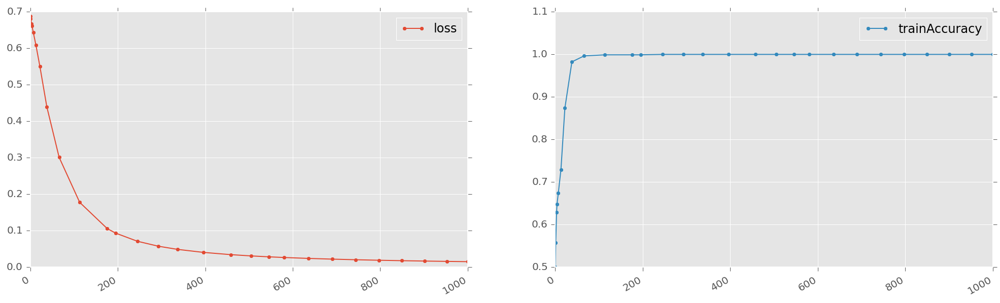

In [6]:
tm=trainedModel(d.xor_dataset,d.xor_labels,[2],plotStep=0.1)
tm.trainingRunData[['loss','trainAccuracy']].plot(subplots=True,layout=(1,2),figsize=[17,5],marker='.');

In [7]:
tm.interactivePlotUsingBokeh()

##### Ring Dataset

   completed step: 1000 of 1000
   time remaining: 0:00:00
             loss: 0.693149089813
training accuracy: 50.00%
  training offset: 0


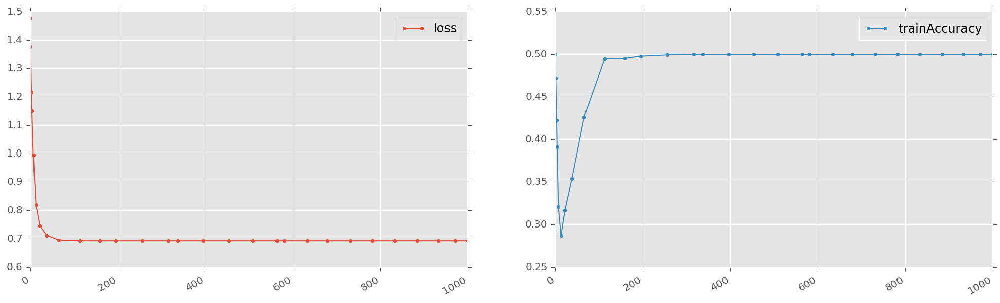

In [8]:
tm=trainedModel(d.ring_dataset,d.ring_labels,[2],plotStep=0.1)
tm.trainingRunData[['loss','trainAccuracy']].plot(subplots=True,layout=(1,2),figsize=[17,5],marker='.');

In [9]:
tm.interactivePlotUsingBokeh()

##### Wiggly Dataset

   completed step: 1000 of 1000
   time remaining: 0:00:00
             loss: 0.0692659318447
training accuracy: 96.53%
  training offset: 0


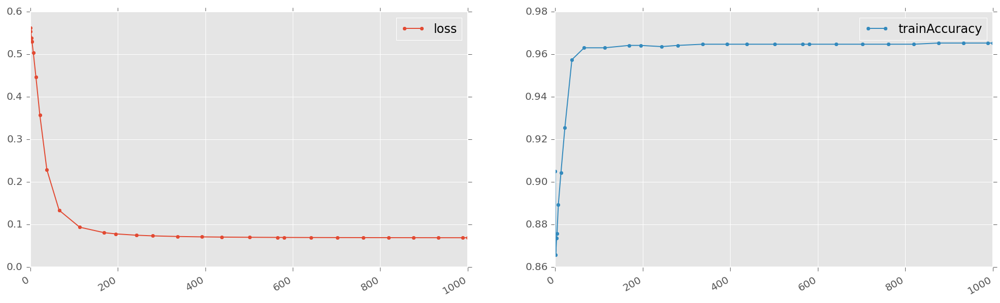

In [10]:
tm=trainedModel(d.wiggly_dataset,d.wiggly_labels,[2],plotStep=0.1)
tm.trainingRunData[['loss','trainAccuracy']].plot(subplots=True,layout=(1,2),figsize=[17,5],marker='.');

In [11]:
tm.interactivePlotUsingBokeh()

# 3 Hidden Units
Here there is enough freedom to capture simple, ring and xor. However they quite often get stuck in a local minima. The training seems to initialy move a very spread out decision boundary around a bit until it looks ok ish, then just maximise on that. It can never go back up the slope to try a different direction.

##### Ring Dataset

##### XOR Dataset

##### Ring2 Dataset

# 4 Hidden Units
This seems to train easier than having just 3 hidden units. But I can't see any improvement in the decision boundary shape. Also sometimes a point ends up miscategorised, but the algorithm doesn't care becuase all the other points are ok.

# 256 Hidden Units
The boundaries seem to be far sharper here. In the simple cases the boundary is very sharp so it doesn't end up in the middle of the two classes; it just slowly moves until the two classes are categorised properly.  
Also this seems to be cable of making a boundary of any shape. What can't this do?

   completed step: 499 of 499
   time remaining: 0:00:00
             loss: 0.000565322174225
training accuracy: 100.00%
  training offset: 0


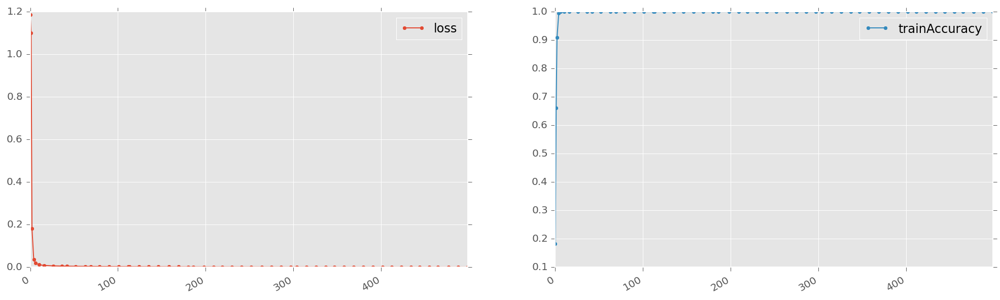

In [22]:
tm=trainedModel(d.simple_dataset,d.simple_labels,[256],plotStep=0.05,numberOfTrainingSteps=500)
tm.trainingRunData[['loss','trainAccuracy']].plot(subplots=True,layout=(1,2),figsize=[17,5],marker='.');

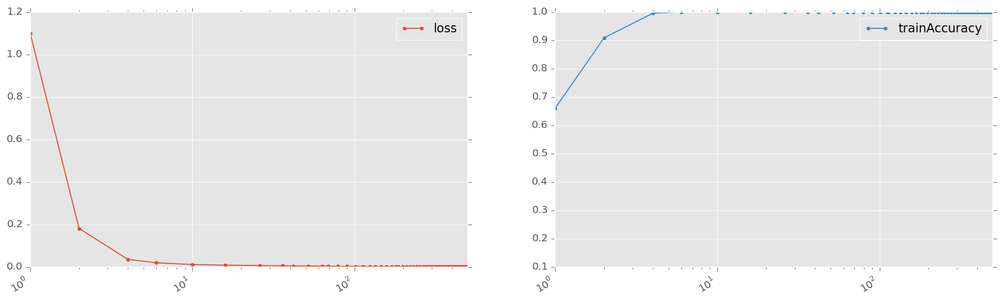

In [23]:
tm.trainingRunData[['loss','trainAccuracy']].plot(logx=True, subplots=True,layout=(1,2),figsize=[17,5],marker='.');

In [24]:
tm.interactivePlotUsingBokeh()

   completed step: 499 of 499
   time remaining: 0:00:00
             loss: 0.000281831831671
training accuracy: 100.00%
  training offset: 0


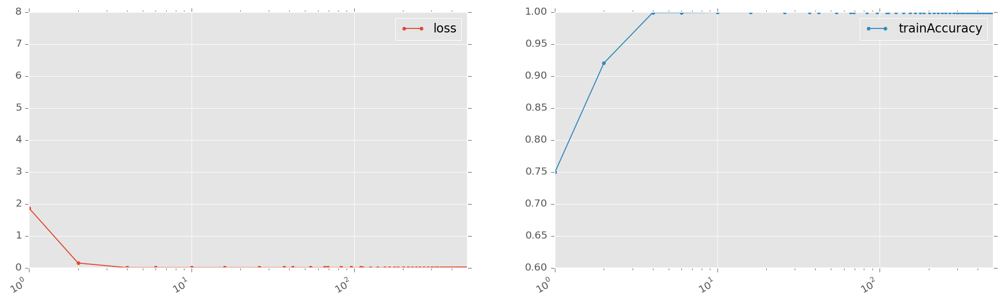

In [25]:
tm=trainedModel(d.xor_dataset,d.xor_labels,[256],plotStep=0.05,numberOfTrainingSteps=500)
tm.trainingRunData[['loss','trainAccuracy']].plot(subplots=True,layout=(1,2),figsize=[17,5],marker='.',logx=True);

In [26]:
tm.interactivePlotUsingBokeh()

I think the above might be what overfitting looks like.  
Regularization would make the boundary wider, hence reducing the overfitting. But you would need to tune the hyperparameter for the data. For some data, like the above, having no scaling works because the distance between the clouds happens to correspond to the rough width of the unaltered softmax boundary.